<a href="https://colab.research.google.com/github/Mahirtayeb1/Citrus-Leaf-Disease-Detection-Using-CNN/blob/main/Unaugmented_dataset_Models_.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [ ]:
# from google.colab import drive
# drive.mount('/content/drive')

In [ ]:
import numpy as np
import os
import PIL
import glob
import keras
from pathlib import Path
from sklearn.metrics import accuracy_score, confusion_matrix, classification_report, ConfusionMatrixDisplay
from sklearn import preprocessing, linear_model
import seaborn as sn; sn.set(font_scale=1.4)
from sklearn.utils import shuffle
import matplotlib.pyplot as plt
import cv2
import tensorflow as tf
from tqdm import tqdm
from tensorflow import keras
from tensorflow.keras.preprocessing import image
from tensorflow.keras.preprocessing.image import ImageDataGenerator
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Input, Dense, Conv2D, MaxPooling2D, Activation, Dropout, Flatten
from tensorflow.keras.utils import to_categorical, plot_model, get_file
from tensorflow.keras.optimizers import Adam
from tensorflow.keras.applications import InceptionV3
from tensorflow.keras.applications import ResNet50
from tensorflow.keras.applications import VGG16
from tensorflow.keras.applications import DenseNet121
from tensorflow.keras.applications import EfficientNetB0
from tensorflow.keras.applications import MobileNetV2
from tensorflow.keras.applications import EfficientNetB7
from tensorflow.keras.applications import DenseNet201
from tensorflow.keras.applications import InceptionResNetV2
from tensorflow.keras.applications.inception_resnet_v2 import preprocess_input
from tensorflow.keras.applications.densenet import preprocess_input
from tensorflow.keras.applications.efficientnet import preprocess_input
from tensorflow.keras.applications.mobilenet_v2 import preprocess_input
from tensorflow.keras.applications import MobileNet
from tensorflow.keras.layers import GlobalAveragePooling2D
from tensorflow.keras.models import Model
from tensorflow.keras.callbacks import ReduceLROnPlateau
# !pip install Augmentor
# !pip install split-folders[full]
# !pip install Augmentor Pillow

2024-01-07 06:10:59.159248: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-07 06:11:01.010149: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer.so.7'; dlerror: libnvinfer.so.7: cannot open shared object file: No such file or directory
2024-01-07 06:11:01.010270: W tensorflow/compiler/xla/stream_executor/platform/default/dso_loader.cc:64] Could not load dynamic library 'libnvinfer_plugin.so.7'; dlerror: libnvinfer_plugin.so.7: cannot open shared object file: No such file or directory
2024-01-07 06:11:01.010280: W tensorflow/compiler/tf2tensorrt/utils/py_utils.cc:38] TF-TRT Warning: Cannot dlopen some TensorRT libraries. If you would like to use Nv

In [ ]:
# print(tf.__version__)
# print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

# physical_devices = tf.config.list_physical_devices('GPU')
# print(physical_devices)
# if len(physical_devices) > 0:
#     tf.config.experimental.set_memory_growth(physical_devices[0], True)

2.11.0
Num GPUs Available:  1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


2024-01-07 06:11:08.520918: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-07 06:11:08.798593: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-07 06:11:08.798664: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.


In [ ]:
import os
import tensorflow as tf

# Set TF_CPP_MIN_LOG_LEVEL to suppress warnings
os.environ['TF_CPP_MIN_LOG_LEVEL'] = '2'

# Rest of your code
print(tf.__version__)
print("Num GPUs Available: ", len(tf.config.list_physical_devices('GPU')))

physical_devices = tf.config.list_physical_devices('GPU')
print(physical_devices)
if len(physical_devices) > 0:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

2.11.0
Num GPUs Available:  1
[PhysicalDevice(name='/physical_device:GPU:0', device_type='GPU')]


In [ ]:
weights_path = '/mnt/d/Undergrad_thesis/h5_unaugmented'

In [ ]:
root_path = '/mnt/d/Undergrad_thesis'
dataset_path = os.path.join(root_path,"Citrus_Leaves") #"/content/drive/MyDrive/Thesis P3/new_citrus_leaves"

In [ ]:
num_of_images = {}

for dir in os.listdir(dataset_path):
  num_of_images[dir] = len(os.listdir(os.path.join(dataset_path, dir)))

In [ ]:
os.getcwd()

'/home/mafatay'

In [ ]:
num_of_images.items()

dict_items([('Black spot', 171), ('canker', 163), ('greening', 204), ('healthy', 58)])

In [ ]:
src = os.listdir(dataset_path)
src

['Black spot', 'canker', 'greening', 'healthy']

In [ ]:
# import Augmentor

# for folder in src:
#   p = Augmentor.Pipeline(
#                           source_directory= os.path.join(dataset_path, folder),
#                           output_directory= os.path.join(root_path, "aug_dataset", "aug_"+folder))

#   p.rotate(probability=0.2, max_left_rotation=2, max_right_rotation=2)
#   p.zoom(probability=0.2, min_factor=1.1, max_factor=1.2)
#   p.skew(probability=0.2)
#   p.random_distortion(probability=0.2, grid_width=100, grid_height=100, magnitude=1)
#   p.shear(probability=0.2, max_shear_left=2, max_shear_right=2)
#   p.crop_random(probability=0.2, percentage_area=0.8)
#   p.flip_random(probability=0.2)
#   p.sample(700)

In [ ]:
# import splitfolders

# input_folder = os.path.join(dataset_path)
# splitfolders.ratio(input_folder, output= os.path.join(root_path, "split_unaugmented"),
#     seed=1337, ratio=(.7, .15, .15), group_prefix=None, move=False)

Copying files: 596 files [00:27, 22.00 files/s]


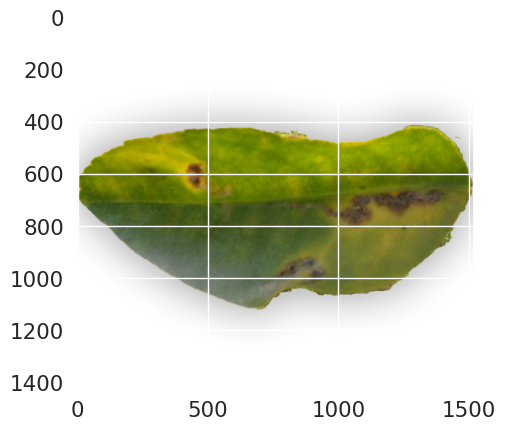

In [ ]:
temp_dir = os.path.join(root_path, 'split_unaugmented', 'train', 'Black spot')
img = image.load_img(os.path.join(temp_dir,os.listdir(temp_dir)[0]))
plt.imshow(img)

In [ ]:
cv2.imread(os.path.join(temp_dir,os.listdir(temp_dir)[0])).shape

(1417, 1520, 3)

In [ ]:
split_aug_path = os.path.join(root_path, 'split_unaugmented') #"/content/drive/MyDrive/Undergrad Thesis/Aug_split_fix"
fnames = os.listdir(split_aug_path)
len(fnames)

3

In [ ]:
fnames

['test', 'train', 'val']

In [ ]:
fnames
split_aug = os.listdir(os.path.join(split_aug_path, fnames[0]))
split_aug

['Black spot', 'canker', 'greening', 'healthy']

Custom Model

In [ ]:
def create_model():
    model = Sequential()

    model.add(Conv2D(filters=32, kernel_size=3, activation='relu', input_shape=(224, 224, 3)))
    model.add(MaxPooling2D(pool_size=2, strides=2))

    model.add(Conv2D(filters=64, kernel_size=3, activation='relu'))
    model.add(MaxPooling2D(pool_size=2, strides=2))
    model.add(Dropout(rate=0.20))

    model.add(Flatten())

    model.add(Dense(units=128, activation='relu'))
    model.add(Dropout(rate=0.25))
    model.add(Dense(units=4, activation='softmax'))

    model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
    # reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

    return model

In [ ]:
model = create_model()

2024-01-05 21:45:07.904489: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-05 21:45:07.907799: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-05 21:45:07.907881: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-05 21:45:07.907931: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_nod

In [ ]:
model.summary()

Model: "sequential"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 conv2d (Conv2D)             (None, 222, 222, 32)      896       
                                                                 
 max_pooling2d (MaxPooling2D  (None, 111, 111, 32)     0         
 )                                                               
                                                                 
 conv2d_1 (Conv2D)           (None, 109, 109, 64)      18496     
                                                                 
 max_pooling2d_1 (MaxPooling  (None, 54, 54, 64)       0         
 2D)                                                             
                                                                 
 dropout (Dropout)           (None, 54, 54, 64)        0         
                                                                 
 flatten (Flatten)           (None, 186624)            0

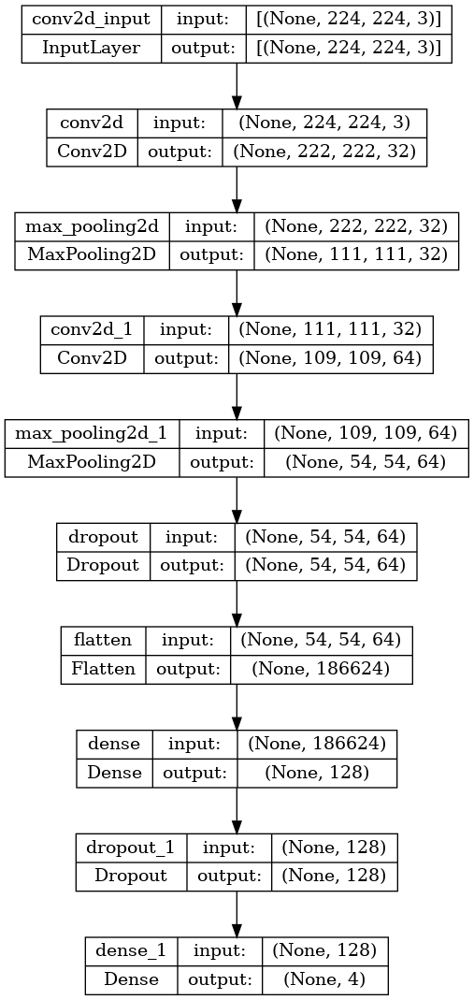

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
from tensorflow.keras.preprocessing.image import ImageDataGenerator

train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,  # Rescale pixel values to the range [0, 1]
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    os.path.join(split_aug_path, 'train'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',  # Using 'categorical' for multi-class classification
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    os.path.join(split_aug_path, 'val'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    os.path.join(split_aug_path, 'test'),
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks = [reduce_lr]
)

Epoch 1/20
13/13 [==============================] - 8s 605ms/step - loss: 0.8171 - accuracy: 0.6530 - val_loss: 0.7581 - val_accuracy: 0.6207 - lr: 1.0000e-04
Epoch 2/20
13/13 [==============================] - 8s 617ms/step - loss: 0.7878 - accuracy: 0.6675 - val_loss: 0.6918 - val_accuracy: 0.7701 - lr: 1.0000e-04
Epoch 3/20
13/13 [==============================] - 7s 543ms/step - loss: 0.7810 - accuracy: 0.6964 - val_loss: 0.6636 - val_accuracy: 0.7816 - lr: 1.0000e-04
Epoch 4/20
13/13 [==============================] - 8s 548ms/step - loss: 0.7055 - accuracy: 0.7181 - val_loss: 0.7989 - val_accuracy: 0.6322 - lr: 1.0000e-04
Epoch 5/20
13/13 [==============================] - 7s 535ms/step - loss: 0.7350 - accuracy: 0.6988 - val_loss: 0.7194 - val_accuracy: 0.6782 - lr: 1.0000e-04
Epoch 6/20
13/13 [==============================] - 7s 530ms/step - loss: 0.7220 - accuracy: 0.6892 - val_loss: 0.5950 - val_accuracy: 0.7816 - lr: 1.0000e-04
Epoch 7/20
13/13 [============================

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'unaug_Custom_cnn.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy}")

3/3 [==============================] - 1s 168ms/step - loss: 0.4470 - accuracy: 0.8298
Test Accuracy: 0.8297872543334961


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.8620689511299133
Corresponding Training Accuracy: 0.759036123752594


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'Custom_cnn.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator)
print(f"Test Accuracy: {test_accuracy}")

3/3 [==============================] - 1s 178ms/step - loss: 0.4470 - accuracy: 0.8298
Test Accuracy: 0.8297872543334961


3/3 [==============================] - 1s 458ms/step


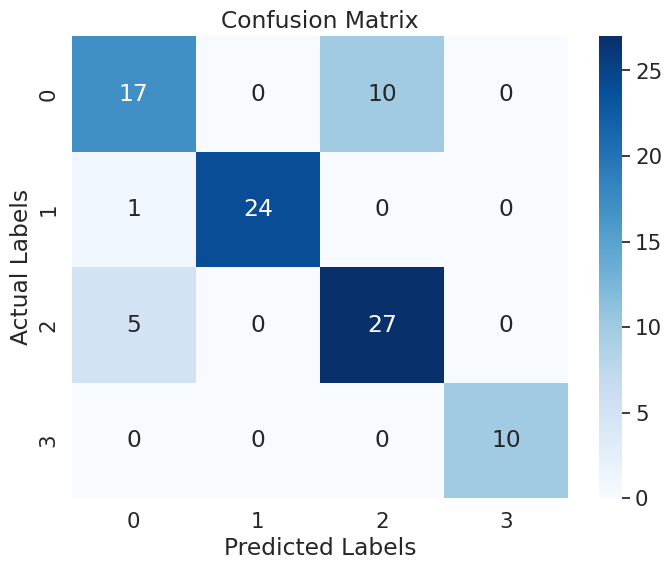

              precision    recall  f1-score   support

           0       0.74      0.63      0.68        27
           1       1.00      0.96      0.98        25
           2       0.73      0.84      0.78        32
           3       1.00      1.00      1.00        10

    accuracy                           0.83        94
   macro avg       0.87      0.86      0.86        94
weighted avg       0.83      0.83      0.83        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)


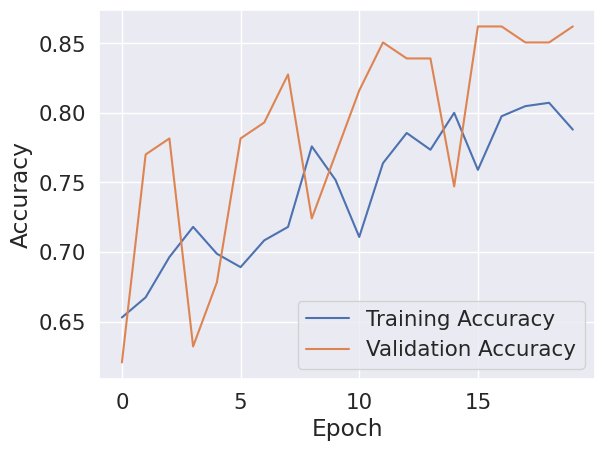

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

In [ ]:
# print(os.getcwd())

PRE TRAINED MODELS

RESNET 50

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = ResNet50(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv1_pad (ZeroPadding2D)      (None, 230, 230, 3)  0           ['input_1[0][0]']                
                                                                                                  
 conv1_conv (Conv2D)            (None, 112, 112, 64  9472        ['conv1_pad[0][0]']              
                                )                                                                 
                                                                                              

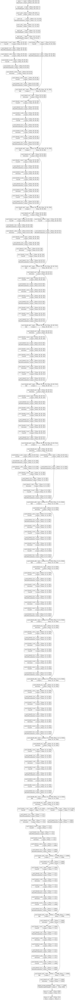

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20


2024-01-05 22:06:04.646218: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.30GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-05 22:06:04.646294: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.30GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-05 22:06:07.050118: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.41GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-05 22:06:07.050181: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU

13/13 [==============================] - 749s 36s/step - loss: 0.7048 - accuracy: 0.7301 - val_loss: 1.6485 - val_accuracy: 0.2874 - lr: 1.0000e-04
Epoch 2/20
13/13 [==============================] - 82s 6s/step - loss: 0.2426 - accuracy: 0.9133 - val_loss: 1.7472 - val_accuracy: 0.3793 - lr: 1.0000e-04
Epoch 3/20
13/13 [==============================] - 85s 7s/step - loss: 0.1339 - accuracy: 0.9566 - val_loss: 2.0895 - val_accuracy: 0.2874 - lr: 1.0000e-04
Epoch 4/20
13/13 [==============================] - 84s 6s/step - loss: 0.0784 - accuracy: 0.9783 - val_loss: 2.3442 - val_accuracy: 0.2874 - lr: 1.0000e-04
Epoch 5/20
13/13 [==============================] - 36s 3s/step - loss: 0.1148 - accuracy: 0.9735 - val_loss: 2.6426 - val_accuracy: 0.2874 - lr: 5.0000e-05
Epoch 6/20
13/13 [==============================] - 35s 3s/step - loss: 0.0549 - accuracy: 0.9831 - val_loss: 2.7767 - val_accuracy: 0.2874 - lr: 5.0000e-05
Epoch 7/20
13/13 [==============================] - 35s 3s/step - l

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'Resnet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 29s 14s/step - loss: 2.9452 - accuracy: 0.2872
Test Loss: 2.945204734802246
Test Accuracy: 0.28723403811454773


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.37931033968925476
Corresponding Training Accuracy: 0.9132530093193054


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'Resnet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 10s 3s/step - loss: 2.9452 - accuracy: 0.2872
Test Loss: 2.945204734802246
Test Accuracy: 0.28723403811454773


3/3 [==============================] - 7s 3s/step


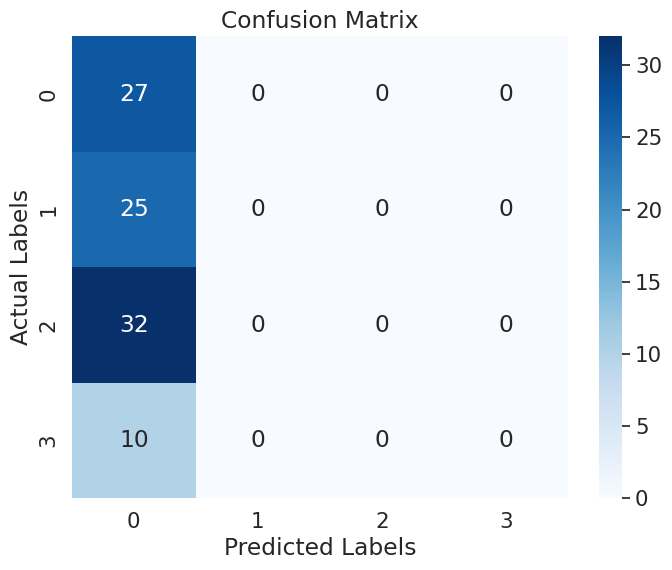

              precision    recall  f1-score   support

           0       0.29      1.00      0.45        27
           1       0.00      0.00      0.00        25
           2       0.00      0.00      0.00        32
           3       0.00      0.00      0.00        10

    accuracy                           0.29        94
   macro avg       0.07      0.25      0.11        94
weighted avg       0.08      0.29      0.13        94



/home/mafatay/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mafatay/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mafatay/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)


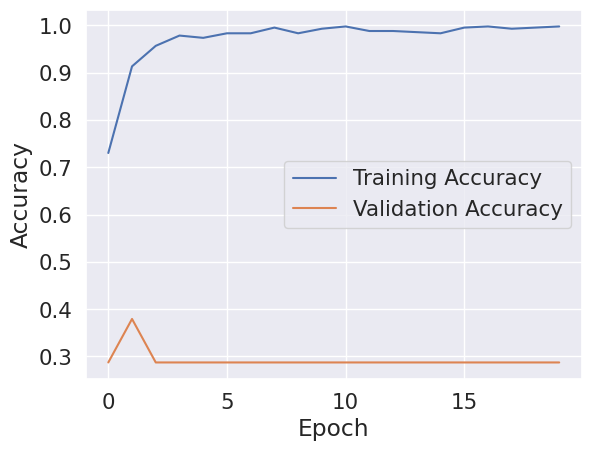

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

InceptionNet V3

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(299, 299),  # InceptionV3 input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(299, 299),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(299, 299),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)


Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = InceptionV3(weights='imagenet', include_top=False, input_shape=(299, 299, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_1"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_2 (InputLayer)           [(None, 299, 299, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d_2 (Conv2D)              (None, 149, 149, 32  864         ['input_2[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 149, 149, 32  96         ['conv2d_2[0][0]']               
 alization)                     )                                                           

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20
13/13 [==============================] - 502s 27s/step - loss: 0.8637 - accuracy: 0.6627 - val_loss: 0.8614 - val_accuracy: 0.6552 - lr: 1.0000e-04
Epoch 2/20
13/13 [==============================] - 176s 14s/step - loss: 0.2582 - accuracy: 0.9229 - val_loss: 0.8395 - val_accuracy: 0.6552 - lr: 1.0000e-04
Epoch 3/20
13/13 [==============================] - 166s 13s/step - loss: 0.1149 - accuracy: 0.9614 - val_loss: 0.8127 - val_accuracy: 0.7126 - lr: 1.0000e-04
Epoch 4/20
13/13 [==============================] - 166s 13s/step - loss: 0.1152 - accuracy: 0.9566 - val_loss: 0.5335 - val_accuracy: 0.7701 - lr: 1.0000e-04
Epoch 5/20
13/13 [==============================] - 188s 15s/step - loss: 0.0566 - accuracy: 0.9807 - val_loss: 0.6163 - val_accuracy: 0.7701 - lr: 1.0000e-04
Epoch 6/20
13/13 [==============================] - 166s 13s/step - loss: 0.0611 - accuracy: 0.9759 - val_loss: 0.4142 - val_accuracy: 0.8276 - lr: 1.0000e-04
Epoch 7/20
13/13 [============================

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'inceptionNet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 56s 26s/step - loss: 0.4368 - accuracy: 0.9043
Test Loss: 0.4368340075016022
Test Accuracy: 0.9042553305625916


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9425287246704102
Corresponding Training Accuracy: 0.9903614521026611


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'inceptionNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 6s 2s/step - loss: 0.4368 - accuracy: 0.9043
Test Loss: 0.4368340075016022
Test Accuracy: 0.9042553305625916


3/3 [==============================] - 3s 830ms/step


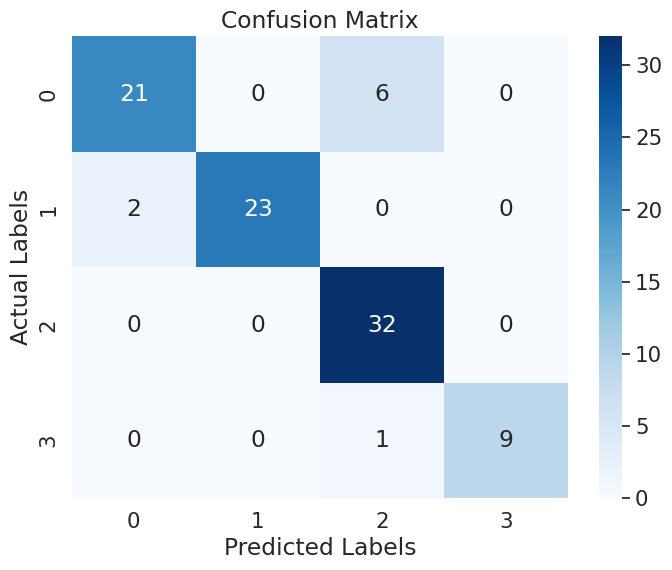

              precision    recall  f1-score   support

           0       0.91      0.78      0.84        27
           1       1.00      0.92      0.96        25
           2       0.82      1.00      0.90        32
           3       1.00      0.90      0.95        10

    accuracy                           0.90        94
   macro avg       0.93      0.90      0.91        94
weighted avg       0.91      0.90      0.90        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

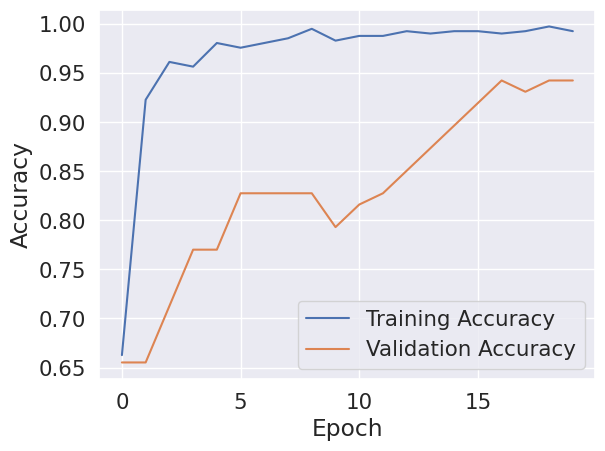

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

VGG16


In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # VGG16 input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = VGG16(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_2"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_3 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 block1_conv1 (Conv2D)       (None, 224, 224, 64)      1792      
                                                                 
 block1_conv2 (Conv2D)       (None, 224, 224, 64)      36928     
                                                                 
 block1_pool (MaxPooling2D)  (None, 112, 112, 64)      0         
                                                                 
 block2_conv1 (Conv2D)       (None, 112, 112, 128)     73856     
                                                                 
 block2_conv2 (Conv2D)       (None, 112, 112, 128)     147584    
                                                                 
 block2_pool (MaxPooling2D)  (None, 56, 56, 128)       0   

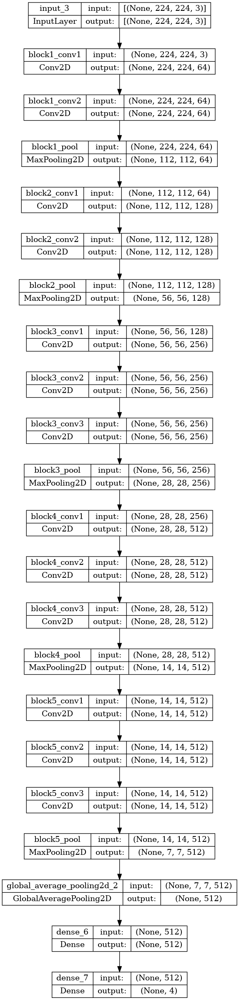

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,  # Adjust the number of epochs as needed
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]
)

Epoch 1/20
13/13 [==============================] - 1085s 67s/step - loss: 1.3340 - accuracy: 0.3325 - val_loss: 1.2859 - val_accuracy: 0.2759 - lr: 1.0000e-04
Epoch 2/20
13/13 [==============================] - 61s 5s/step - loss: 1.2039 - accuracy: 0.4554 - val_loss: 0.9553 - val_accuracy: 0.5517 - lr: 1.0000e-04
Epoch 3/20
13/13 [==============================] - 63s 5s/step - loss: 1.0214 - accuracy: 0.5157 - val_loss: 0.8908 - val_accuracy: 0.5747 - lr: 1.0000e-04
Epoch 4/20
13/13 [==============================] - 69s 5s/step - loss: 0.8894 - accuracy: 0.5542 - val_loss: 0.9159 - val_accuracy: 0.6092 - lr: 1.0000e-04
Epoch 5/20
13/13 [==============================] - 69s 5s/step - loss: 0.8316 - accuracy: 0.6000 - val_loss: 0.7777 - val_accuracy: 0.6322 - lr: 1.0000e-04
Epoch 6/20
13/13 [==============================] - 69s 5s/step - loss: 0.8069 - accuracy: 0.6530 - val_loss: 0.7483 - val_accuracy: 0.6092 - lr: 1.0000e-04
Epoch 7/20
13/13 [==============================] - 69s

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'vgg.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 399s 199s/step - loss: 0.6488 - accuracy: 0.8191
Test Loss: 0.6488450169563293
Test Accuracy: 0.8191489577293396


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9195402264595032
Corresponding Training Accuracy: 0.9204819202423096


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'vgg.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 12s 4s/step - loss: 0.6488 - accuracy: 0.8191
Test Loss: 0.6488450169563293
Test Accuracy: 0.8191489577293396


3/3 [==============================] - 8s 4s/step


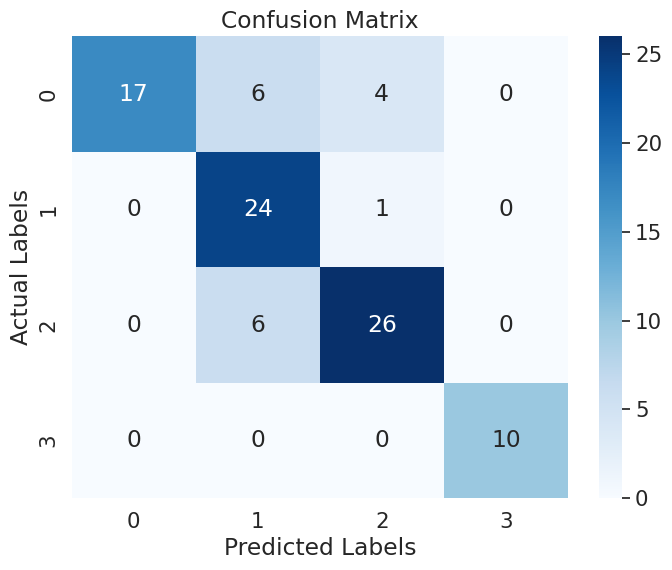

              precision    recall  f1-score   support

           0       1.00      0.63      0.77        27
           1       0.67      0.96      0.79        25
           2       0.84      0.81      0.83        32
           3       1.00      1.00      1.00        10

    accuracy                           0.82        94
   macro avg       0.88      0.85      0.85        94
weighted avg       0.86      0.82      0.82        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

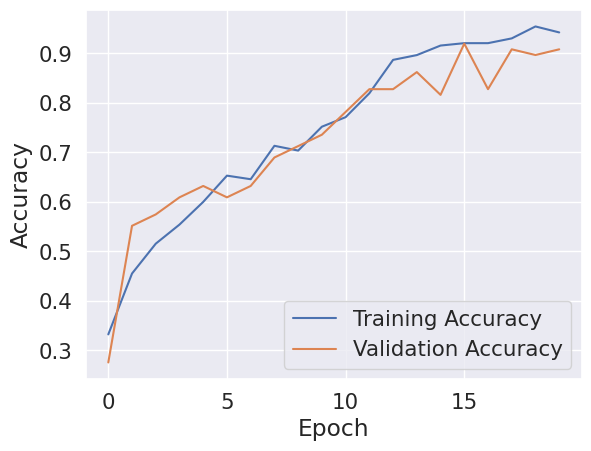

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

DenseNet121

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # DenseNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = DenseNet121(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

2024-01-06 00:41:04.690467: I tensorflow/core/platform/cpu_feature_guard.cc:193] This TensorFlow binary is optimized with oneAPI Deep Neural Network Library (oneDNN) to use the following CPU instructions in performance-critical operations:  AVX2 FMA
To enable them in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-01-06 00:41:04.692656: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 00:41:04.692740: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-06 00:41:04.692791: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_nod

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(lr=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-06 00:41:40.436478: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8101
2024-01-06 00:41:41.041133: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: Permission denied
2024-01-06 00:42:12.489768: I tensorflow/compiler/xla/service/service.cc:173] XLA service 0x7f777802bf40 initialized for platform CUDA (this does not guarantee that XLA will be used). Devices:
2024-01-06 00:42:12.489834: I tensorflow/compiler/xla/service/service.cc:181]   StreamExecutor device (0): NVIDIA GeForce RTX 2080, Compute Capability 7.5
2024-01-06 00:42:12.498520: I tensorflow/compiler/mlir/tensorflow/utils/dump_mlir_util.cc:268] disabling MLIR crash reproducer, set env var `MLIR_CRASH_REPRODUCER_DIRECTORY` to enable.
2024-01-06 00:42:12.655563: I tensorflow/tsl/platform/default/subprocess.cc:304] Start cannot spawn child process: Permission denied
2024-01-06 00:42:12.704934: I tensorflow/compiler/jit/xla_compilation_cache.cc:477]

13/13 [==============================] - 407s 17s/step - loss: 0.8809 - accuracy: 0.7060 - val_loss: 3.0790 - val_accuracy: 0.4828 - lr: 0.0010
Epoch 2/20
13/13 [==============================] - 68s 5s/step - loss: 0.2428 - accuracy: 0.9277 - val_loss: 14.7859 - val_accuracy: 0.3333 - lr: 0.0010
Epoch 3/20
13/13 [==============================] - 69s 5s/step - loss: 0.2720 - accuracy: 0.9133 - val_loss: 5.5731 - val_accuracy: 0.5057 - lr: 0.0010
Epoch 4/20
13/13 [==============================] - 69s 5s/step - loss: 0.2124 - accuracy: 0.9133 - val_loss: 3.6899 - val_accuracy: 0.6552 - lr: 0.0010
Epoch 5/20
13/13 [==============================] - 69s 5s/step - loss: 0.1823 - accuracy: 0.9229 - val_loss: 1.0230 - val_accuracy: 0.7011 - lr: 5.0000e-04
Epoch 6/20
13/13 [==============================] - 69s 5s/step - loss: 0.1132 - accuracy: 0.9663 - val_loss: 0.8496 - val_accuracy: 0.6667 - lr: 5.0000e-04
Epoch 7/20
13/13 [==============================] - 69s 5s/step - loss: 0.1114 - a

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'denseNet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 37s 18s/step - loss: 0.6481 - accuracy: 0.7766
Test Loss: 0.6480585932731628
Test Accuracy: 0.7765957713127136


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.8390804529190063
Corresponding Training Accuracy: 0.9855421781539917


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'denseNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 3s 1s/step - loss: 0.6481 - accuracy: 0.7766
Test Loss: 0.6480585932731628
Test Accuracy: 0.7765957713127136


3/3 [==============================] - 4s 950ms/step


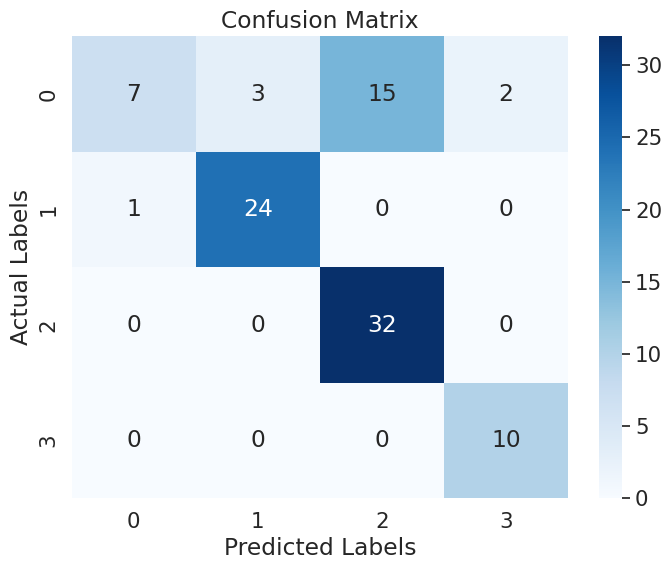

              precision    recall  f1-score   support

           0       0.88      0.26      0.40        27
           1       0.89      0.96      0.92        25
           2       0.68      1.00      0.81        32
           3       0.83      1.00      0.91        10

    accuracy                           0.78        94
   macro avg       0.82      0.80      0.76        94
weighted avg       0.81      0.78      0.73        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

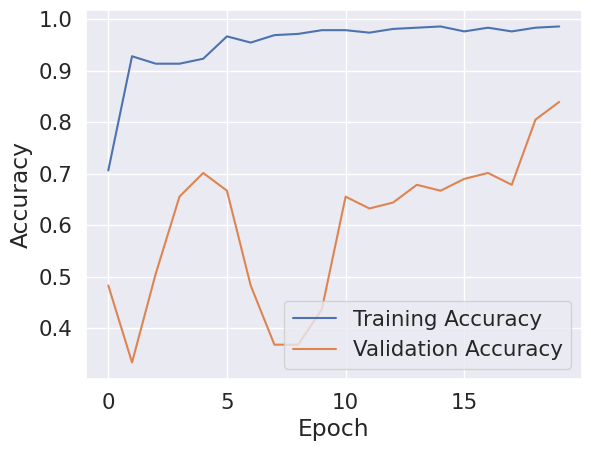

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

MobileNet

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = MobileNet(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
# from tensorflow.keras.models import load_model, save_model

# # Assuming you have a trained model named 'model'
# model.save(os.path.join(dataset_path,'../mobileNet.h5'))  # Save the model to a file

In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(lr=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_1"
_________________________________________________________________
 Layer (type)                Output Shape              Param #   
 input_2 (InputLayer)        [(None, 224, 224, 3)]     0         
                                                                 
 conv1 (Conv2D)              (None, 112, 112, 32)      864       
                                                                 
 conv1_bn (BatchNormalizatio  (None, 112, 112, 32)     128       
 n)                                                              
                                                                 
 conv1_relu (ReLU)           (None, 112, 112, 32)      0         
                                                                 
 conv_dw_1 (DepthwiseConv2D)  (None, 112, 112, 32)     288       
                                                                 
 conv_dw_1_bn (BatchNormaliz  (None, 112, 112, 32)     128       
 ation)                                                    

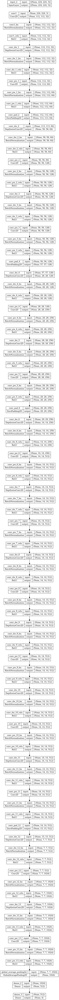

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-06 01:11:11.008995: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.34GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-06 01:11:11.009062: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.34GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-06 01:11:11.366552: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.34GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-06 01:11:11.366620: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU

 8/13 [=================>............] - ETA: 4s - loss: 1.4790 - accuracy: 0.6250

2024-01-06 01:11:30.372778: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.34GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-06 01:11:30.372846: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.34GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-06 01:11:30.391497: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 2.34GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-06 01:11:30.391564: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU

13/13 [==============================] - 41s 2s/step - loss: 1.0722 - accuracy: 0.6892 - val_loss: 4.8638 - val_accuracy: 0.4483 - lr: 0.0010
Epoch 2/20
13/13 [==============================] - 14s 1s/step - loss: 0.4104 - accuracy: 0.8410 - val_loss: 7.1787 - val_accuracy: 0.3563 - lr: 0.0010
Epoch 3/20
13/13 [==============================] - 14s 1s/step - loss: 0.2342 - accuracy: 0.8988 - val_loss: 7.7864 - val_accuracy: 0.3678 - lr: 0.0010
Epoch 4/20
13/13 [==============================] - 14s 1s/step - loss: 0.1424 - accuracy: 0.9470 - val_loss: 9.2464 - val_accuracy: 0.3563 - lr: 0.0010
Epoch 5/20
13/13 [==============================] - 14s 1s/step - loss: 0.1094 - accuracy: 0.9566 - val_loss: 9.4357 - val_accuracy: 0.3448 - lr: 5.0000e-04
Epoch 6/20
13/13 [==============================] - 14s 1s/step - loss: 0.1012 - accuracy: 0.9663 - val_loss: 10.1253 - val_accuracy: 0.3448 - lr: 5.0000e-04
Epoch 7/20
13/13 [==============================] - 14s 1s/step - loss: 0.0731 - acc

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'mobileNet.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 7s 3s/step - loss: 1.1481 - accuracy: 0.7660
Test Loss: 1.148091197013855
Test Accuracy: 0.7659574747085571


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.8390804529190063
Corresponding Training Accuracy: 0.983132541179657


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'mobileNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 2s 542ms/step - loss: 1.1481 - accuracy: 0.7660
Test Loss: 1.148091197013855
Test Accuracy: 0.7659574747085571


3/3 [==============================] - 2s 598ms/step


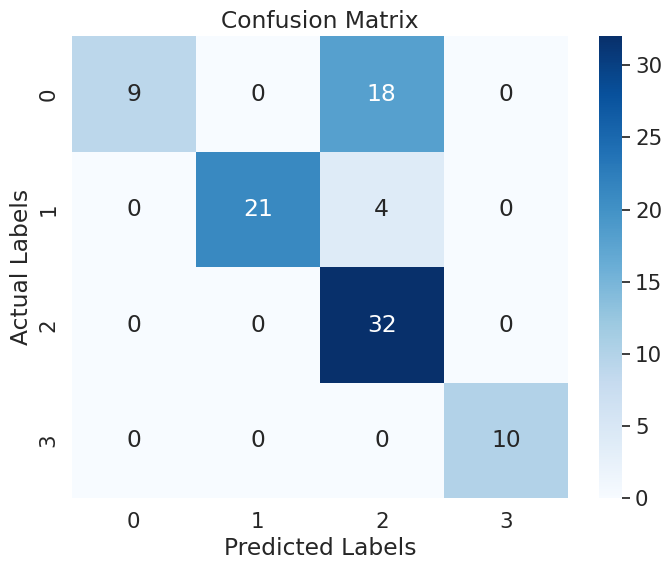

              precision    recall  f1-score   support

           0       1.00      0.33      0.50        27
           1       1.00      0.84      0.91        25
           2       0.59      1.00      0.74        32
           3       1.00      1.00      1.00        10

    accuracy                           0.77        94
   macro avg       0.90      0.79      0.79        94
weighted avg       0.86      0.77      0.75        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

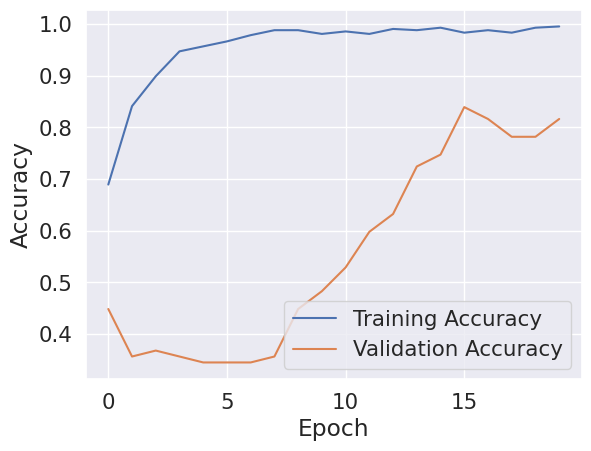

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

EfficientNet

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # EfficientNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = EfficientNetB0(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:
# Add custom classification layers on top of the EfficientNet base model
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_2"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_3 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling (Rescaling)          (None, 224, 224, 3)  0           ['input_3[0][0]']                
                                                                                                  
 normalization (Normalization)  (None, 224, 224, 3)  7           ['rescaling[0][0]']              
                                                                                                  
 rescaling_1 (Rescaling)        (None, 224, 224, 3)  0           ['normalization[0][0]']    

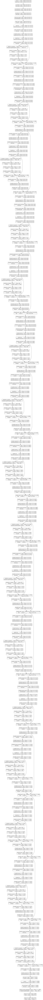

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-06 01:16:39.457906: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_2/block2b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


13/13 [==============================] - 117s 7s/step - loss: 1.1974 - accuracy: 0.5036 - val_loss: 1.5181 - val_accuracy: 0.0920 - lr: 1.0000e-04
Epoch 2/20
13/13 [==============================] - 53s 4s/step - loss: 0.7194 - accuracy: 0.7807 - val_loss: 1.4571 - val_accuracy: 0.0920 - lr: 1.0000e-04
Epoch 3/20
13/13 [==============================] - 52s 4s/step - loss: 0.4770 - accuracy: 0.8458 - val_loss: 1.4411 - val_accuracy: 0.3448 - lr: 1.0000e-04
Epoch 4/20
13/13 [==============================] - 53s 4s/step - loss: 0.3300 - accuracy: 0.9036 - val_loss: 1.4386 - val_accuracy: 0.3448 - lr: 1.0000e-04
Epoch 5/20
13/13 [==============================] - 49s 4s/step - loss: 0.2283 - accuracy: 0.9277 - val_loss: 1.4395 - val_accuracy: 0.2759 - lr: 1.0000e-04
Epoch 6/20
13/13 [==============================] - 48s 4s/step - loss: 0.1824 - accuracy: 0.9349 - val_loss: 1.4338 - val_accuracy: 0.0920 - lr: 1.0000e-04
Epoch 7/20
13/13 [==============================] - 54s 4s/step - lo

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'efficientnet.h5'), save_format='h5')  # Save the model to a file


TypeError: Unable to serialize [2.0896919 2.1128857 2.1081853] to JSON. Unrecognized type <class 'tensorflow.python.framework.ops.EagerTensor'>.

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

In [ ]:
loaded_model = load_model(os.path.join(weights_path,'efficientNet.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

EfficientNet B7

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
physical_devices = tf.config.list_physical_devices('GPU')
if physical_devices:
    tf.config.experimental.set_memory_growth(physical_devices[0], True)

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=8,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
# from tensorflow.keras.applications import EfficientNetB7
# from tensorflow.keras.applications.efficientnet import preprocess_input

base_model = EfficientNetB7(weights='imagenet', include_top=False, input_shape=(224, 224, 3))  # EfficientNet B7 has a different input size

In [ ]:

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

# Other parts of the code (data generators, training, evaluation) remain the same.


In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_3"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_4 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 rescaling_2 (Rescaling)        (None, 224, 224, 3)  0           ['input_4[0][0]']                
                                                                                                  
 normalization_1 (Normalization  (None, 224, 224, 3)  7          ['rescaling_2[0][0]']            
 )                                                                                                
                                                                                            

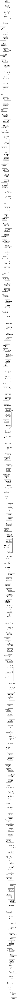

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-06 01:50:58.604874: E tensorflow/core/grappler/optimizers/meta_optimizer.cc:954] layout failed: INVALID_ARGUMENT: Size of values 0 does not match size of permutation 4 @ fanin shape inmodel_3/block1b_drop/dropout/SelectV2-2-TransposeNHWCToNCHW-LayoutOptimizer


52/52 [==============================] - 1435s 8s/step - loss: 0.8842 - accuracy: 0.6602 - val_loss: 1.5001 - val_accuracy: 0.2874 - lr: 1.0000e-04
Epoch 2/20
52/52 [==============================] - 400s 8s/step - loss: 0.3954 - accuracy: 0.8651 - val_loss: 1.6593 - val_accuracy: 0.3448 - lr: 1.0000e-04
Epoch 3/20
52/52 [==============================] - 434s 8s/step - loss: 0.2834 - accuracy: 0.8892 - val_loss: 1.8803 - val_accuracy: 0.3448 - lr: 1.0000e-04
Epoch 4/20
52/52 [==============================] - 839s 16s/step - loss: 0.2236 - accuracy: 0.9253 - val_loss: 1.6124 - val_accuracy: 0.3448 - lr: 1.0000e-04
Epoch 5/20
52/52 [==============================] - 734s 14s/step - loss: 0.1720 - accuracy: 0.9518 - val_loss: 1.7413 - val_accuracy: 0.3448 - lr: 5.0000e-05
Epoch 6/20
52/52 [==============================] - 1519s 29s/step - loss: 0.1375 - accuracy: 0.9446 - val_loss: 1.4988 - val_accuracy: 0.3448 - lr: 5.0000e-05
Epoch 7/20
52/52 [==============================] - 385s 7

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'EfficientB7Net.h5'))  # Save the model to a file

TypeError: Unable to serialize [2.0896919 2.1128857 2.1081853] to JSON. Unrecognized type <class 'tensorflow.python.framework.ops.EagerTensor'>.

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

In [ ]:
loaded_model = load_model(os.path.join(weights_path,'EfficientB7Net.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

DenseNet201

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=8,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=8,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = DenseNet201(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

In [ ]:

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_4"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_5 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 zero_padding2d_2 (ZeroPadding2  (None, 230, 230, 3)  0          ['input_5[0][0]']                
 D)                                                                                               
                                                                                                  
 conv1/conv (Conv2D)            (None, 112, 112, 64  9408        ['zero_padding2d_2[0][0]']       
                                )                                                           

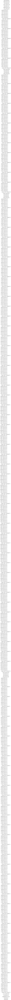

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20
52/52 [==============================] - 423s 3s/step - loss: 0.6527 - accuracy: 0.7398 - val_loss: 0.7146 - val_accuracy: 0.7356 - lr: 1.0000e-04
Epoch 2/20
52/52 [==============================] - 193s 4s/step - loss: 0.2878 - accuracy: 0.8867 - val_loss: 0.6136 - val_accuracy: 0.7701 - lr: 1.0000e-04
Epoch 3/20
52/52 [==============================] - 262s 5s/step - loss: 0.1948 - accuracy: 0.9253 - val_loss: 0.3191 - val_accuracy: 0.9080 - lr: 1.0000e-04
Epoch 4/20
52/52 [==============================] - 276s 5s/step - loss: 0.1974 - accuracy: 0.9349 - val_loss: 0.2925 - val_accuracy: 0.9310 - lr: 1.0000e-04
Epoch 5/20
52/52 [==============================] - 358s 7s/step - loss: 0.2059 - accuracy: 0.9301 - val_loss: 0.5250 - val_accuracy: 0.8391 - lr: 1.0000e-04
Epoch 6/20
52/52 [==============================] - 229s 4s/step - loss: 0.1179 - accuracy: 0.9639 - val_loss: 0.2356 - val_accuracy: 0.9080 - lr: 1.0000e-04
Epoch 7/20
52/52 [==============================] - 

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'denseNet201.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

12/12 [==============================] - 146s 13s/step - loss: 0.3825 - accuracy: 0.9149
Test Loss: 0.3824516534805298
Test Accuracy: 0.914893627166748


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.977011501789093
Corresponding Training Accuracy: 0.983132541179657


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'denseNet201.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

12/12 [==============================] - 21s 2s/step - loss: 0.3825 - accuracy: 0.9149
Test Loss: 0.3824516534805298
Test Accuracy: 0.914893627166748


12/12 [==============================] - 22s 2s/step


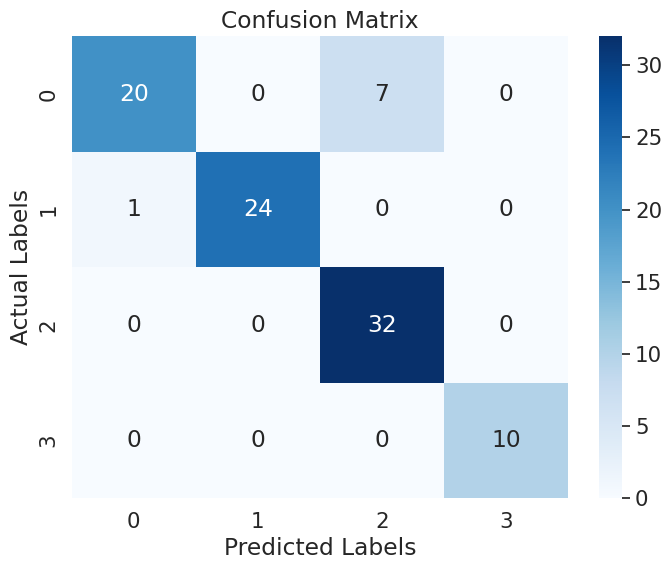

              precision    recall  f1-score   support

           0       0.95      0.74      0.83        27
           1       1.00      0.96      0.98        25
           2       0.82      1.00      0.90        32
           3       1.00      1.00      1.00        10

    accuracy                           0.91        94
   macro avg       0.94      0.93      0.93        94
weighted avg       0.93      0.91      0.91        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

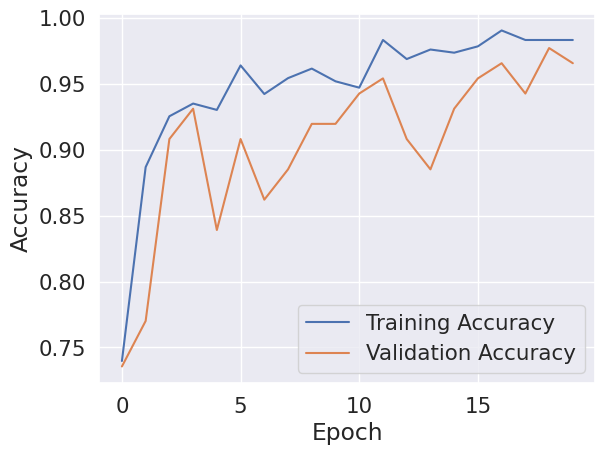

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

InceptionResnet

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=16,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=16,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=16,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = InceptionResNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

2024-01-07 06:13:10.567162: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-07 06:13:10.567272: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-07 06:13:10.567323: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-07 06:13:12.095205: I tensorflow/compiler/xla/stream_executor/cuda/cuda_gpu_executor.cc:967] could not open file to read NUMA node: /sys/bus/pci/devices/0000:41:00.0/numa_node
Your kernel may have been built without NUMA support.
2024-01-07 06:13:12.096046: I tensorflow/compile

In [ ]:

x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_1 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 conv2d (Conv2D)                (None, 111, 111, 32  864         ['input_1[0][0]']                
                                )                                                                 
                                                                                                  
 batch_normalization (BatchNorm  (None, 111, 111, 32  96         ['conv2d[0][0]']                 
 alization)                     )                                                             

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20


2024-01-07 06:14:26.742438: I tensorflow/compiler/xla/stream_executor/cuda/cuda_dnn.cc:428] Loaded cuDNN version 8101
2024-01-07 06:14:31.558047: W tensorflow/tsl/framework/bfc_allocator.cc:360] Garbage collection: deallocate free memory regions (i.e., allocations) so that we can re-allocate a larger region to avoid OOM due to memory fragmentation. If you see this message frequently, you are running near the threshold of the available device memory and re-allocation may incur great performance overhead. You may try smaller batch sizes to observe the performance impact. Set TF_ENABLE_GPU_GARBAGE_COLLECTION=false if you'd like to disable this feature.
2024-01-07 06:14:31.731112: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 6.95GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-07 06:14:31.731180: W tensorflo

18/26 [===================>..........] - ETA: 2s - loss: 0.9521 - accuracy: 0.6250

2024-01-07 06:15:17.699289: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 6.95GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-07 06:15:17.699369: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 6.95GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-07 06:15:17.721750: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU_0_bfc) ran out of memory trying to allocate 6.93GiB with freed_by_count=0. The caller indicates that this is not a failure, but this may mean that there could be performance gains if more memory were available.
2024-01-07 06:15:17.721810: W tensorflow/tsl/framework/bfc_allocator.cc:290] Allocator (GPU

26/26 [==============================] - 95s 505ms/step - loss: 0.8317 - accuracy: 0.6699 - val_loss: 1.1100 - val_accuracy: 0.6667 - lr: 1.0000e-04
Epoch 2/20
26/26 [==============================] - 8s 296ms/step - loss: 0.2974 - accuracy: 0.9036 - val_loss: 0.9306 - val_accuracy: 0.7586 - lr: 1.0000e-04
Epoch 3/20
26/26 [==============================] - 8s 285ms/step - loss: 0.1941 - accuracy: 0.9229 - val_loss: 0.8986 - val_accuracy: 0.7816 - lr: 1.0000e-04
Epoch 4/20
26/26 [==============================] - 8s 283ms/step - loss: 0.1348 - accuracy: 0.9687 - val_loss: 1.0302 - val_accuracy: 0.7586 - lr: 1.0000e-04
Epoch 5/20
26/26 [==============================] - 8s 284ms/step - loss: 0.0903 - accuracy: 0.9663 - val_loss: 0.6508 - val_accuracy: 0.8391 - lr: 1.0000e-04
Epoch 6/20
26/26 [==============================] - 8s 282ms/step - loss: 0.0871 - accuracy: 0.9639 - val_loss: 0.4080 - val_accuracy: 0.8621 - lr: 1.0000e-04
Epoch 7/20
26/26 [==============================] - 8s 2

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'InceptionResNetV2.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

6/6 [==============================] - 2s 295ms/step - loss: 0.6162 - accuracy: 0.9043
Test Loss: 0.6162346005439758
Test Accuracy: 0.9042553305625916


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.9425287246704102
Corresponding Training Accuracy: 0.983132541179657


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'InceptionResNetV2.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

6/6 [==============================] - 4s 111ms/step - loss: 0.6162 - accuracy: 0.9043
Test Loss: 0.6162346005439758
Test Accuracy: 0.9042553305625916


6/6 [==============================] - 4s 156ms/step


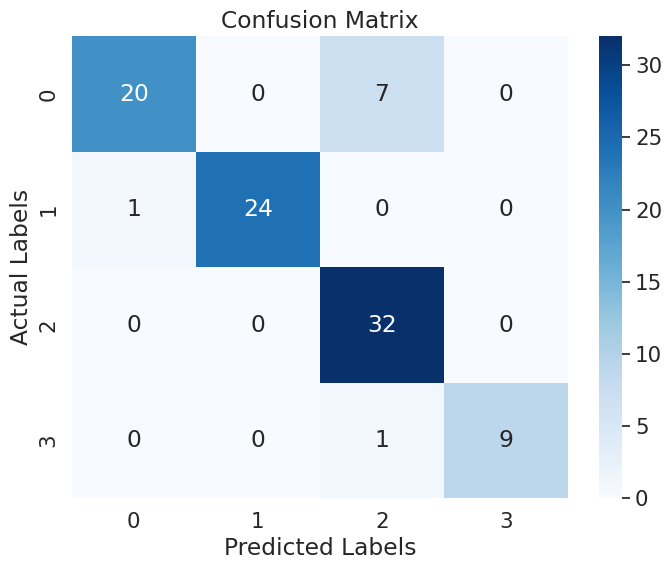

              precision    recall  f1-score   support

           0       0.95      0.74      0.83        27
           1       1.00      0.96      0.98        25
           2       0.80      1.00      0.89        32
           3       1.00      0.90      0.95        10

    accuracy                           0.90        94
   macro avg       0.94      0.90      0.91        94
weighted avg       0.92      0.90      0.90        94



In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

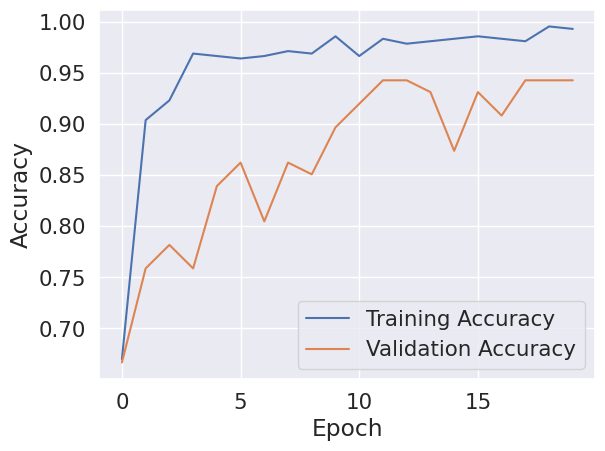

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()

MobileNetV2

In [ ]:
train_dir = os.path.join(split_aug_path, 'train')
test_dir = os.path.join(split_aug_path, 'test')
val_dir = os.path.join(split_aug_path, 'val')

In [ ]:
# Create data generators with data augmentation for the training set and no augmentation for the validation and test sets
train_datagen = ImageDataGenerator(
    rescale=1.0 / 255,
    rotation_range=20,
    width_shift_range=0.2,
    height_shift_range=0.2,
    shear_range=0.2,
    zoom_range=0.2,
    horizontal_flip=True,
    fill_mode='nearest'
)

test_datagen = ImageDataGenerator(rescale=1.0 / 255)

train_generator = train_datagen.flow_from_directory(
    train_dir,
    target_size=(224, 224),  # MobileNet input size
    batch_size=32,
    class_mode='categorical',  # For 5 classes
    shuffle=True
)

validation_generator = test_datagen.flow_from_directory(
    val_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

test_generator = test_datagen.flow_from_directory(
    test_dir,
    target_size=(224, 224),
    batch_size=32,
    class_mode='categorical',
    shuffle=False
)

Found 415 images belonging to 4 classes.
Found 87 images belonging to 4 classes.
Found 94 images belonging to 4 classes.


In [ ]:
base_model = MobileNetV2(weights='imagenet', include_top=False, input_shape=(224, 224, 3))

9406464/9406464 [==============================] - 5s 1us/step


In [ ]:
x = base_model.output
x = GlobalAveragePooling2D()(x)
x = Dense(512, activation='relu')(x)
predictions = Dense(4, activation='softmax')(x)  # Output layer with 5 classes

model = Model(inputs=base_model.input, outputs=predictions)

In [ ]:
model.compile(optimizer=Adam(learning_rate=0.0001), loss='categorical_crossentropy', metrics=['accuracy'])

In [ ]:
reduce_lr = ReduceLROnPlateau(monitor='val_loss', factor=0.5, patience=3, min_lr=1e-6)

In [ ]:
model.summary()

Model: "model_5"
__________________________________________________________________________________________________
 Layer (type)                   Output Shape         Param #     Connected to                     
 input_6 (InputLayer)           [(None, 224, 224, 3  0           []                               
                                )]                                                                
                                                                                                  
 Conv1 (Conv2D)                 (None, 112, 112, 32  864         ['input_6[0][0]']                
                                )                                                                 
                                                                                                  
 bn_Conv1 (BatchNormalization)  (None, 112, 112, 32  128         ['Conv1[0][0]']                  
                                )                                                           

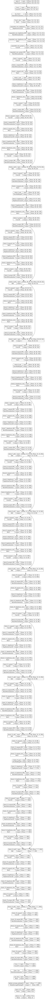

In [ ]:
plot_model(model, show_shapes=True, show_layer_names=True)

In [ ]:
history = model.fit(
    train_generator,
    steps_per_epoch=len(train_generator),
    epochs=20,
    validation_data=validation_generator,
    validation_steps=len(validation_generator),
    callbacks=[reduce_lr]  # Include the ReduceLROnPlateau callback
)

Epoch 1/20
13/13 [==============================] - 156s 9s/step - loss: 1.1177 - accuracy: 0.5108 - val_loss: 1.5260 - val_accuracy: 0.3678 - lr: 1.0000e-04
Epoch 2/20
13/13 [==============================] - 73s 5s/step - loss: 0.4761 - accuracy: 0.8337 - val_loss: 2.0555 - val_accuracy: 0.3563 - lr: 1.0000e-04
Epoch 3/20
13/13 [==============================] - 73s 6s/step - loss: 0.3217 - accuracy: 0.8940 - val_loss: 2.4813 - val_accuracy: 0.3563 - lr: 1.0000e-04
Epoch 4/20
13/13 [==============================] - 65s 5s/step - loss: 0.2140 - accuracy: 0.9422 - val_loss: 3.8134 - val_accuracy: 0.3448 - lr: 1.0000e-04
Epoch 5/20
13/13 [==============================] - 62s 5s/step - loss: 0.1686 - accuracy: 0.9301 - val_loss: 4.0347 - val_accuracy: 0.3448 - lr: 5.0000e-05
Epoch 6/20
13/13 [==============================] - 69s 5s/step - loss: 0.1411 - accuracy: 0.9518 - val_loss: 4.4012 - val_accuracy: 0.3448 - lr: 5.0000e-05
Epoch 7/20
13/13 [==============================] - 94s 8

In [ ]:
from tensorflow.keras.models import load_model, save_model

# Assuming you have a trained model named 'model'
model.save(os.path.join(weights_path,'mobileNetV2.h5'))  # Save the model to a file

In [ ]:
test_loss, test_accuracy = model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 48s 19s/step - loss: 4.3598 - accuracy: 0.3404
Test Loss: 4.359818935394287
Test Accuracy: 0.3404255211353302


In [ ]:
# Find the epoch with the best validation accuracy
best_epoch = np.argmax(history.history['val_accuracy'])

# Print the best validation accuracy and corresponding training accuracy
best_val_accuracy = history.history['val_accuracy'][best_epoch]
corresponding_train_accuracy = history.history['accuracy'][best_epoch]

print(f"Best Validation Accuracy: {best_val_accuracy}")
print(f"Corresponding Training Accuracy: {corresponding_train_accuracy}")

Best Validation Accuracy: 0.36781609058380127
Corresponding Training Accuracy: 0.5108433961868286


In [ ]:
loaded_model = load_model(os.path.join(weights_path,'mobileNetV2.h5'))  # Load the model from the HDF5 file
test_loss, test_accuracy = loaded_model.evaluate(test_generator, steps=len(test_generator))
print(f'Test Loss: {test_loss}')
print(f'Test Accuracy: {test_accuracy}')

3/3 [==============================] - 17s 5s/step - loss: 4.3598 - accuracy: 0.3404
Test Loss: 4.359818935394287
Test Accuracy: 0.3404255211353302


3/3 [==============================] - 9s 4s/step


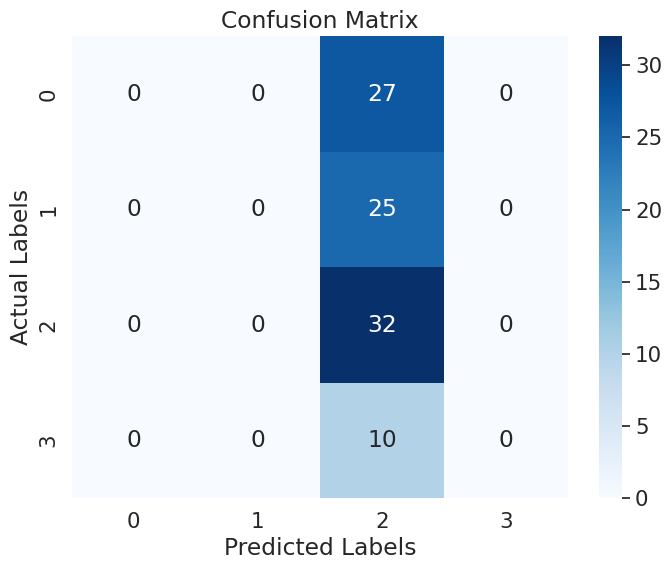

              precision    recall  f1-score   support

           0       0.00      0.00      0.00        27
           1       0.00      0.00      0.00        25
           2       0.34      1.00      0.51        32
           3       0.00      0.00      0.00        10

    accuracy                           0.34        94
   macro avg       0.09      0.25      0.13        94
weighted avg       0.12      0.34      0.17        94



/home/mafatay/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mafatay/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
/home/mafatay/.local/lib/python3.10/site-packages/sklearn/metrics/_classification.py:1471: UndefinedMetricWarning: Precision and F-score are ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))


In [ ]:
import numpy as np
import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix, classification_report

# Make predictions on the test data using your model
predictions = model.predict(test_generator)

# Get the actual class labels
actual_labels = test_generator.classes

# Convert predicted probabilities to class labels
predicted_labels = np.argmax(predictions, axis=1)

# Calculate the confusion matrix
confusion = confusion_matrix(actual_labels, predicted_labels)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(8, 6))
sns.heatmap(confusion, annot=True, fmt='d', cmap='Blues', xticklabels=np.unique(actual_labels), yticklabels=np.unique(actual_labels))
plt.xlabel('Predicted Labels')
plt.ylabel('Actual Labels')
plt.title('Confusion Matrix')
plt.show()

# Generate a classification report
class_report = classification_report(actual_labels, predicted_labels)
print(class_report)

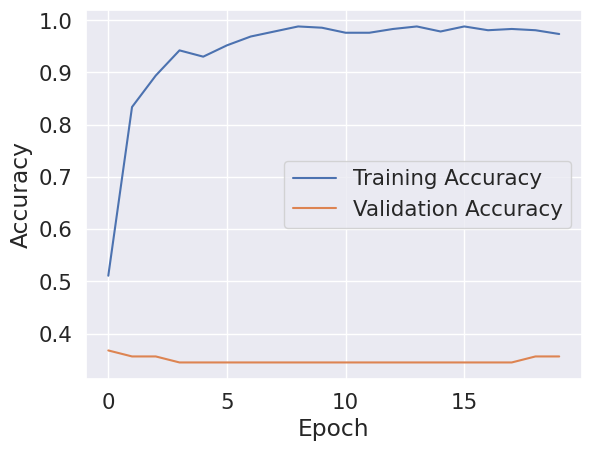

In [ ]:
# For example, to plot the training and validation accuracy:
import matplotlib.pyplot as plt

plt.plot(history.history['accuracy'], label='Training Accuracy')
plt.plot(history.history['val_accuracy'], label='Validation Accuracy')
plt.xlabel('Epoch')
plt.ylabel('Accuracy')
plt.legend()
plt.show()